In [1]:
import numpy as np 
import pandas as pd 
import re
import matplotlib.pyplot as plt
import seaborn as sns
sns.set_style("whitegrid"); 
plt.rcParams['figure.dpi'] = 360  
from wordcloud import WordCloud 
import spacy
from spacy.lang.en import English 
nlp = English() 
from collections import Counter 
import random
from essential_generators import DocumentGenerator

%matplotlib inline

In [2]:
tw = pd.read_csv('twitterdata.csv')
tw.head()

,id,status,gender,email,age,messages,likes,retweets,name,twitter post
0,f31d9ee9-9c41-4446-abd5-0094d65f5f92,offline,male,int@puband.jp,74,4322,1646,1824,Sult Few,Nomenclature differentiating by Claes Oldenbur...
1,ffee8acb-f9ff-48dc-9532-c6dc47cfeee8,anonymous,male,isidue429@Islati.ru,17,822,4245,2407,Bies Th,"Ada Yonath, critical in forensic investigation..."
2,46fc9083-7442-4887-86ac-5d4f78f1f8b1,anonymous,female,therna@cing.us,69,4010,4038,1109,An Of,"Snow fell St. Jean-Baptiste Day ceremony, and ..."
3,771685d0-ba4a-4c3b-abd0-2817ab6f1081,online,female,edrom@upopor.biz,30,976,2838,4903,Sed Beenum,"1883. It nations, thereby avoiding armed confl..."
4,259ccb80-f4db-4d1a-916a-7979d69a3cbd,offline,male,the.Belsou@peoper.ingic.com,66,1410,932,4161,199 Chand,"Of its bodies, a form of government. Senators ..."


In [3]:
tw.describe()

,age,messages,likes,retweets
count,50000.000000,50000.000000,50000.000000,50000.00000
mean,44.280000,2487.273260,2492.623440,2497.24998
std,20.190165,1436.927739,1441.685768,1446.25142
min,10.000000,0.000000,0.000000,0.00000
25%,27.000000,1256.000000,1240.000000,1238.00000
50%,44.000000,2471.500000,2484.000000,2503.00000
75%,62.000000,3729.000000,3734.000000,3749.00000
max,79.000000,4999.000000,4999.000000,4999.00000


In [4]:
# FUCTIONS
def femalegroups(i1,i2):
    df = tw
    df = df[df.gender == 'female']
    df = df[df.age.between(i1,i2)]
    return df

def malegroups(i1,i2):
    df = tw
    df = df[df.gender == 'male']
    df = df[df.age.between(i1,i2)]
    return df

def string(group):
    text = group['twitter post'].values
    text = str(text)
    text = text.lower()
    return text

def cloud(group):
    wordcloud = WordCloud(background_color='white', max_words=50).generate(group)
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis("off")
    plt.show()

#for saving
def cloudsave(group,filename):
    wordcloud = WordCloud(background_color='white', max_words=50).generate(group)
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis("off")
    plt.savefig(filename)
    plt.show()

Female tweeters


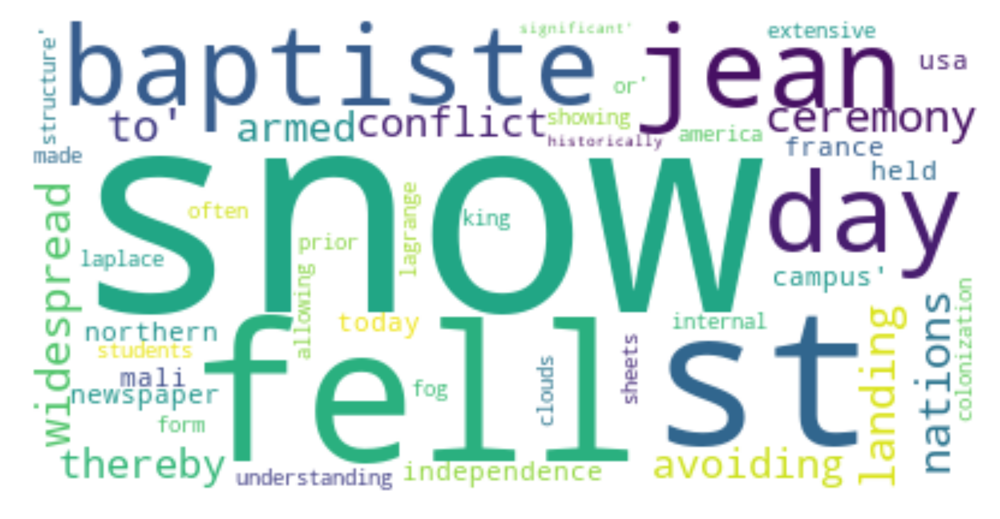

Male tweeters


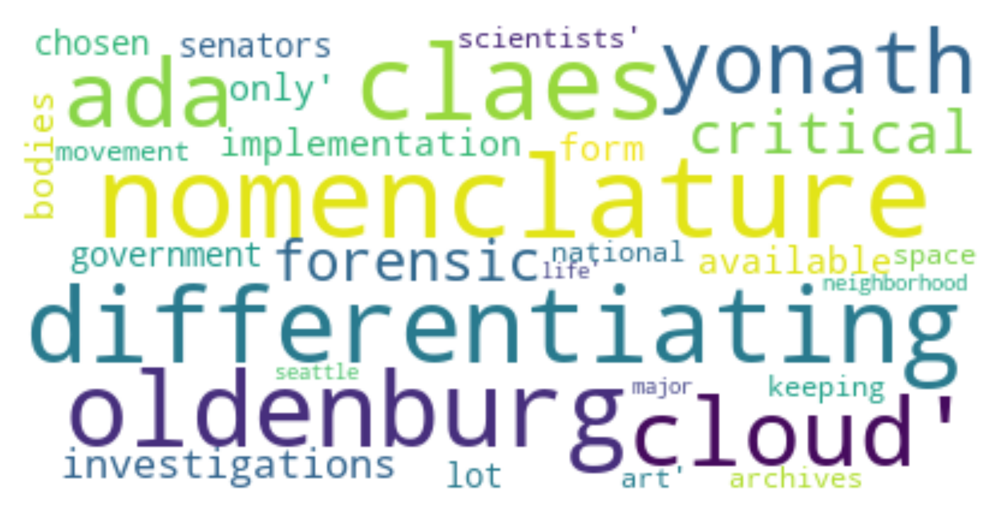

In [5]:
femaleg = tw[tw['gender'] == 'female']
maleg = tw[tw['gender'] != 'female']
print('Female tweeters')
cloud(string(femaleg))
print('Male tweeters')
cloud(string(maleg))

In [6]:
# GENDER & AGE GROUPS

teenf = femalegroups(10,19)
twf = femalegroups(20,29)
thrf = femalegroups(30,39)
forf = femalegroups(40,49)
fiff = femalegroups(50,59)
sixf = femalegroups(60,69)
sevf = femalegroups(70,79)

teenm = malegroups(10,19)
twm = malegroups(20,29)
thrm = malegroups(30,39)
form = malegroups(40,49)
fifm = malegroups(50,59)
sixm = malegroups(60,69)
sevm = malegroups(70,79)

In [7]:
fgroup = {'Teen females' : string(teenf),
          'Females in their 20s': string(teenf), 
          'Females in their 30s': string(twf),
          'Females in their 40s': string(thrf),
          'Females in their 50s': string(forf),
          'Females in their 60s': string(sixf),
          'Females in their 70s': string(sevf)
         }

mgroup = {'Teen males' : string(teenm),
          'Males in their 20s': string(twm),
          'Males in their 30s': string(thrm),
          'Males in their 40s': string(form),
          'Males in their 50s': string(fifm),
          'Males in their 60s': string(sixm),
          'Males in their 70s': string(sevm)
         }

Teen females


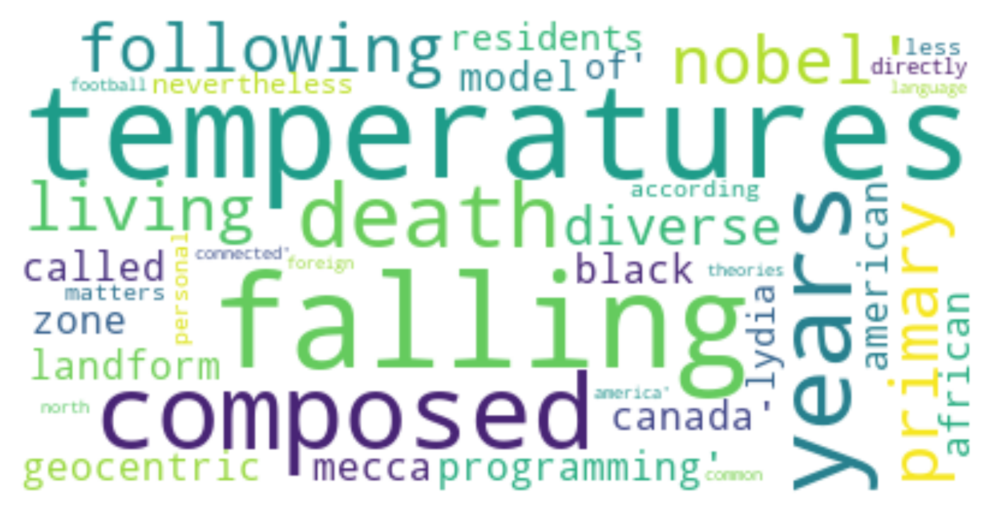

Females in their 20s


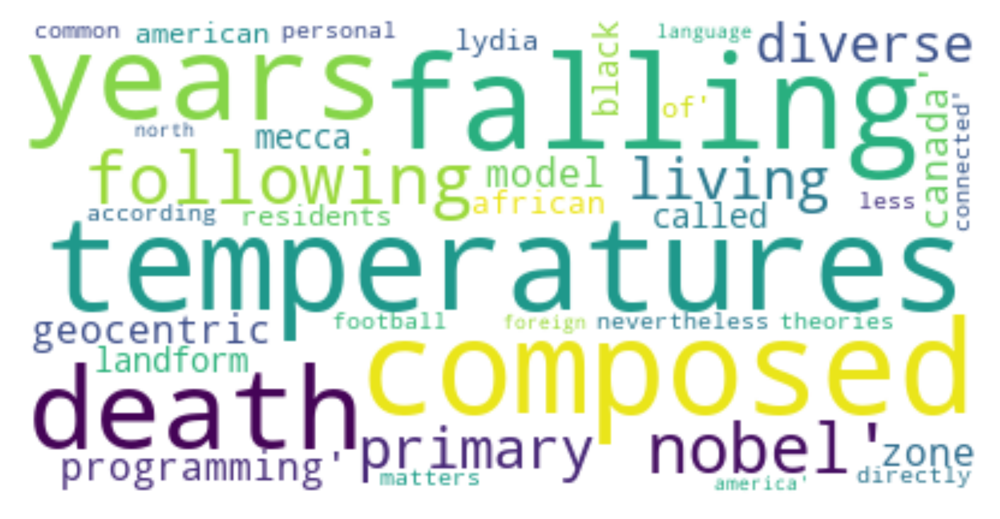

Females in their 30s


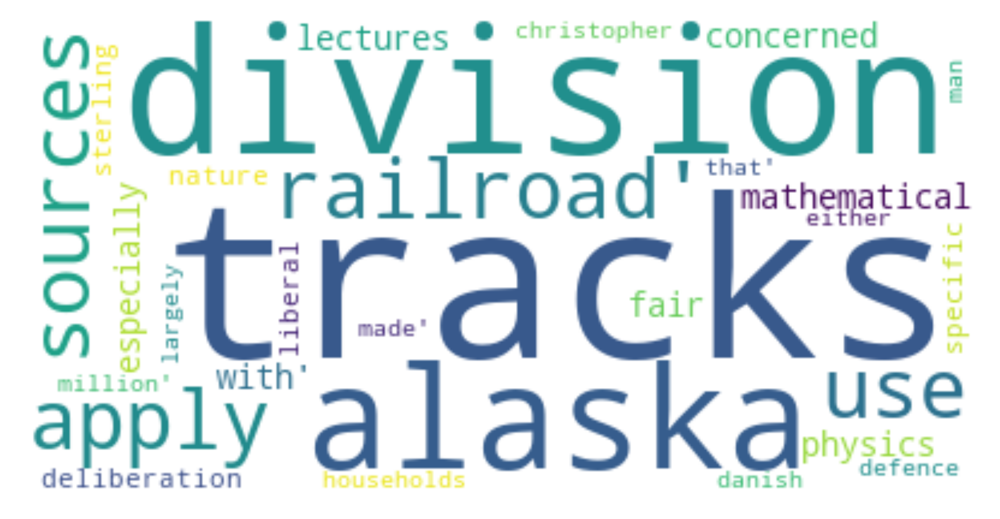

Females in their 40s


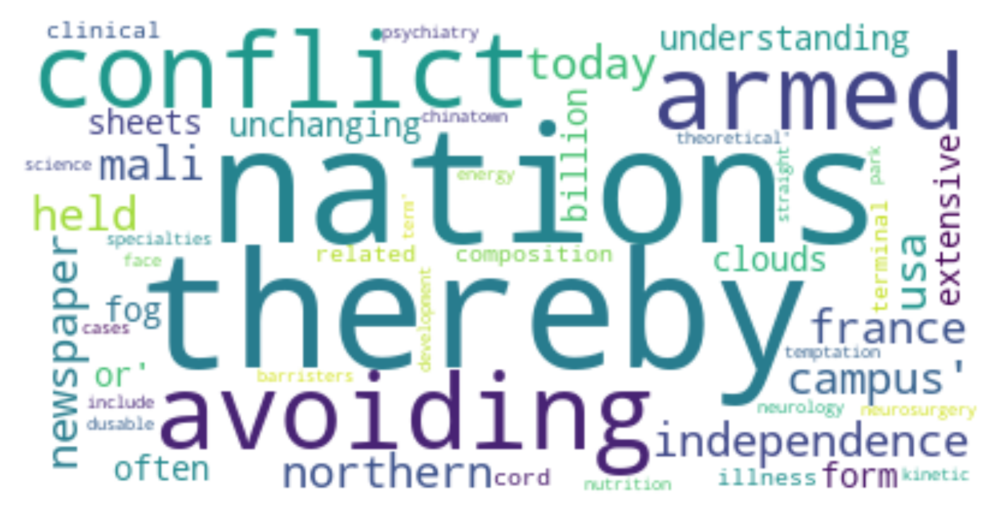

Females in their 50s


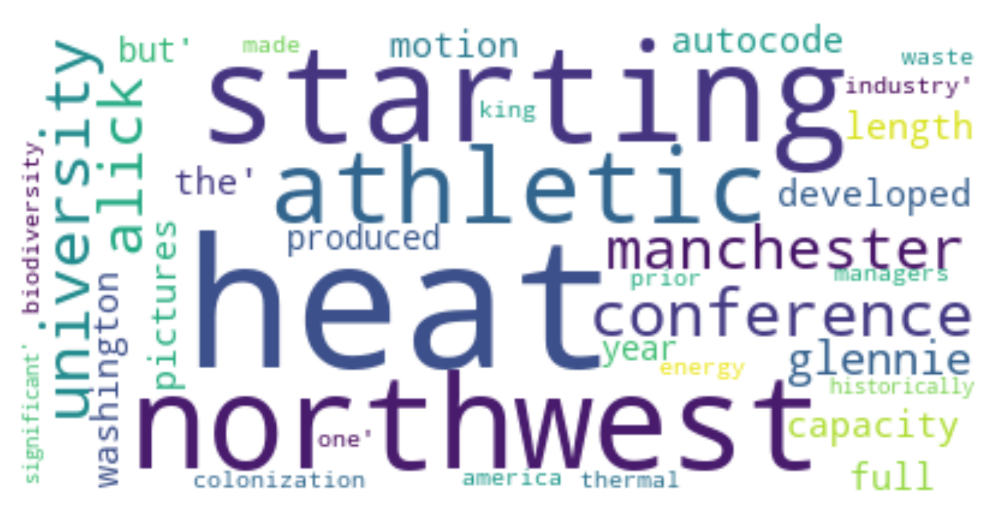

Females in their 60s


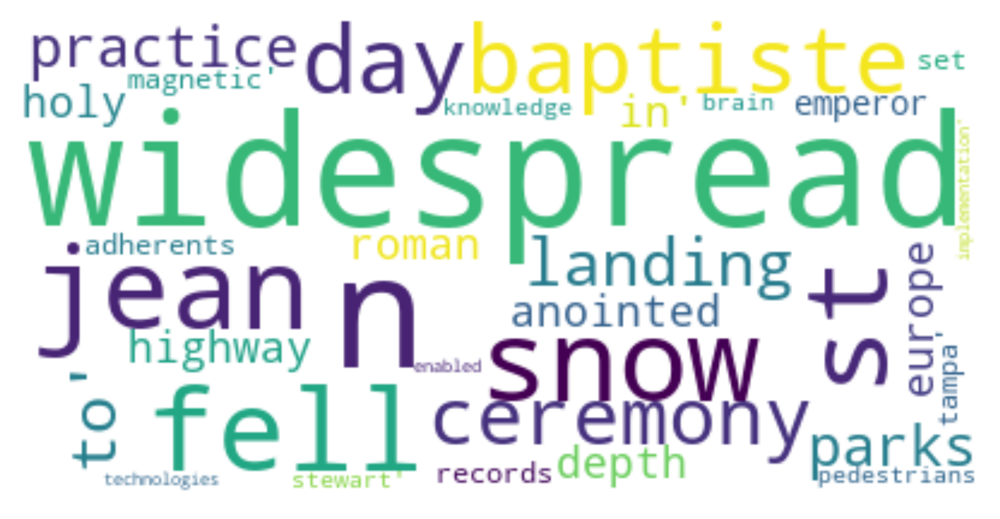

Females in their 70s


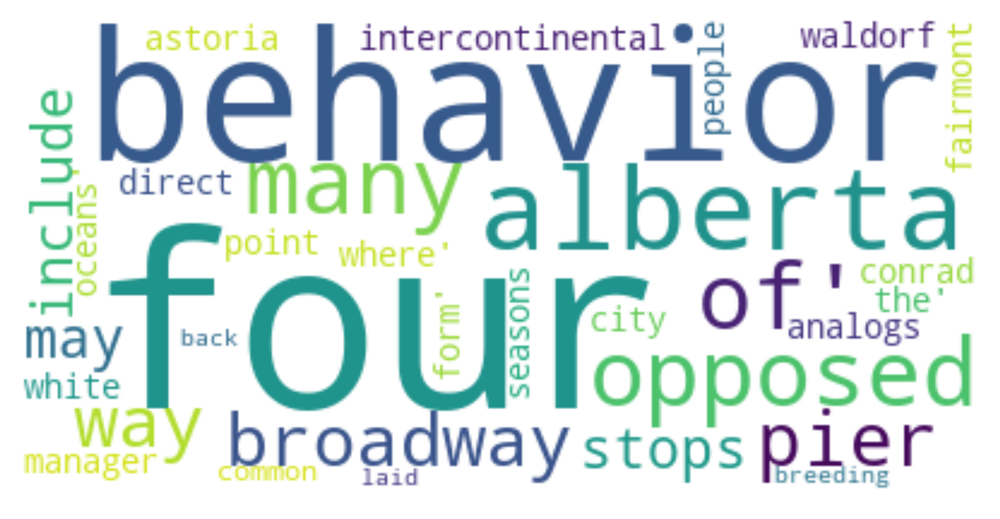

In [8]:
# Female group

for key, value in fgroup.items():
    print(key)
    cloud(value)

Teen males


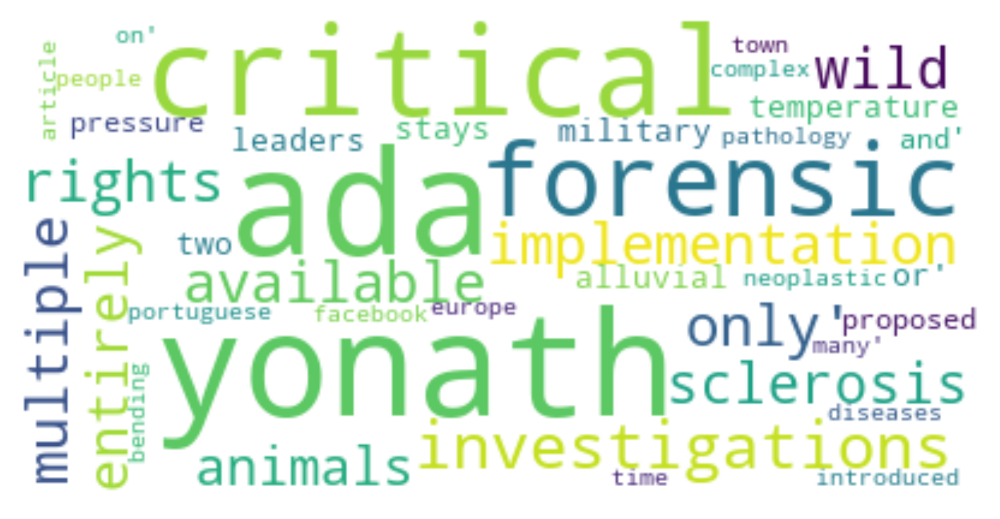

Males in their 20s


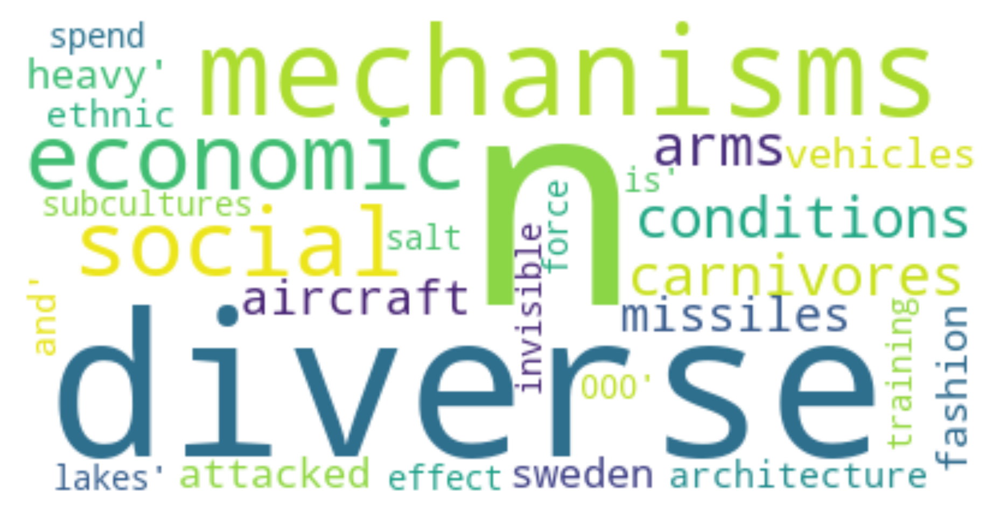

Males in their 30s


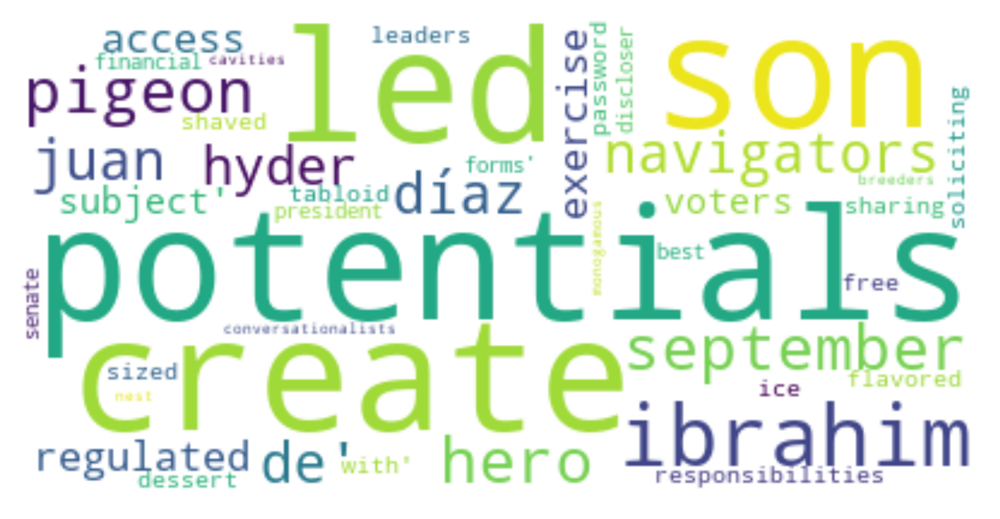

Males in their 40s


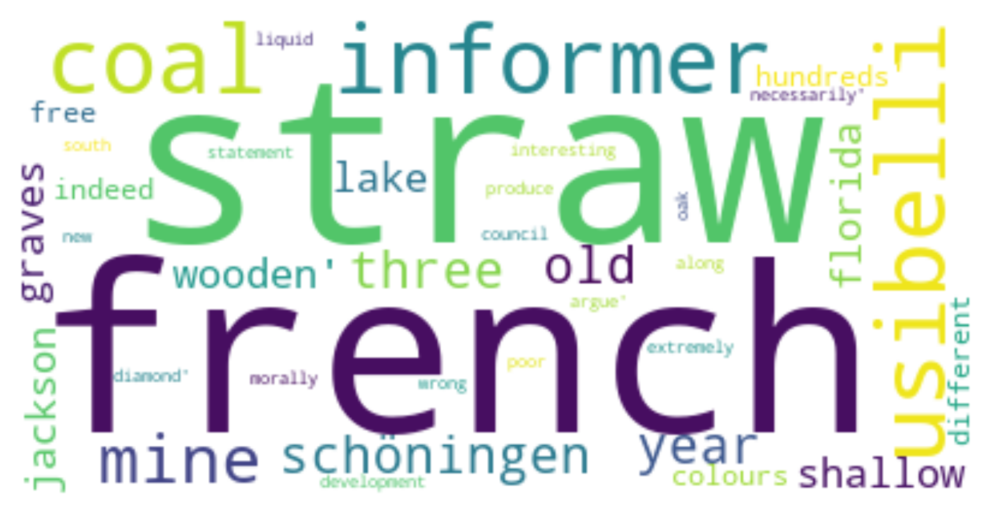

Males in their 50s


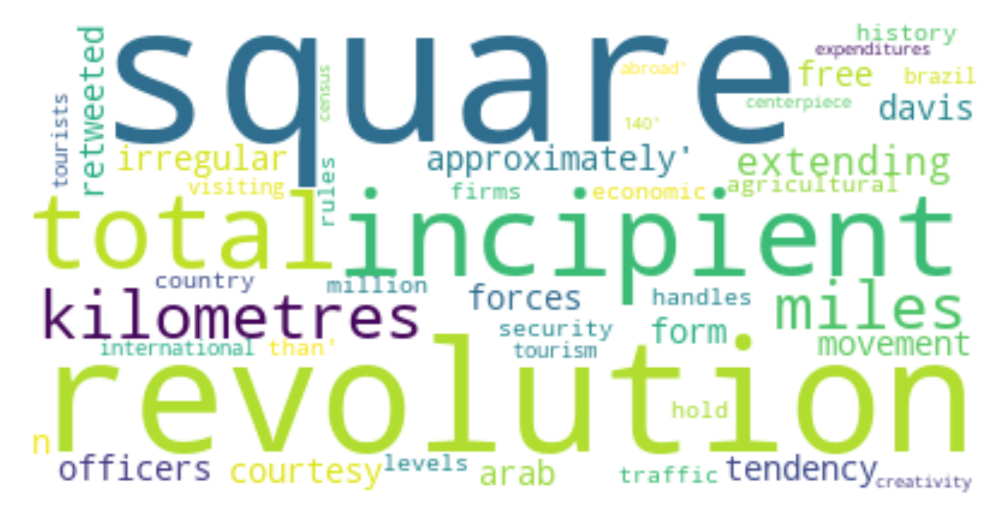

Males in their 60s


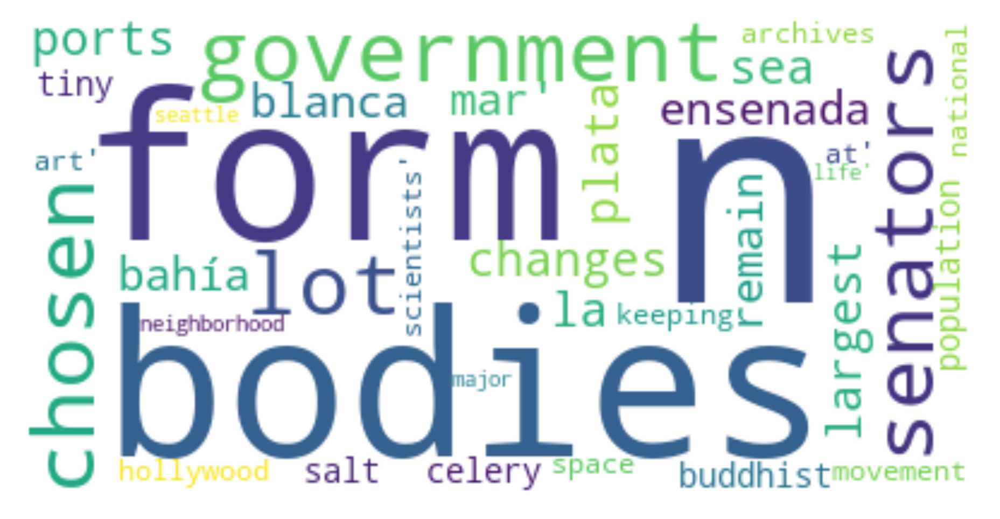

Males in their 70s


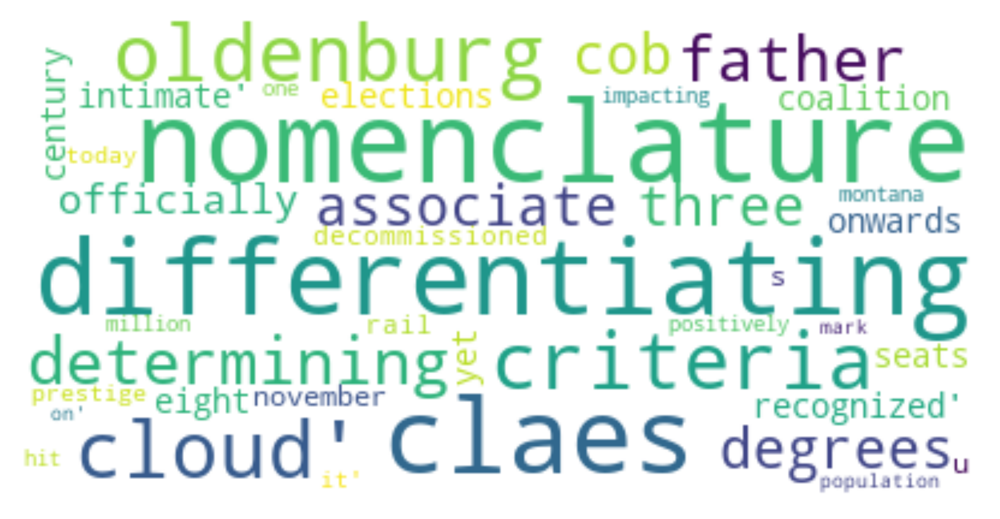

In [9]:
# Male group
for key, value in mgroup.items():
    print(key)
    cloud(value)

In [10]:
# High engagement tweets only
pop = tw
pop = pop[pop.messages > 2500]
pop = pop[pop.likes > 2500]
pop = pop[pop.retweets > 2500]

In [11]:
pop.head()

,id,status,gender,email,age,messages,likes,retweets,name,twitter post
6,8519f086-3d9e-4a9f-b8d2-55a096475322,offline,male,of@Flopet.tv,21,4364,2610,3853,Ing Ind,"Diverse mechanisms economic, social conditions."
15,90a0be8d-887b-43e3-9d63-effc4be36537,anonymous,female,belit@Mancle.jp,28,2784,4903,4803,Lat Mixeco,"Great certainty at Poplar, and Chippewa-Cree o..."
27,64041474-59d2-4b31-8ae7-33536ad0bca6,offline,female,hand@col.com,13,4994,4711,3160,Ent Is,"1610, and geocentric model of the Canada"
30,ea3291f9-5656-4b30-9954-011ade0ffe0c,offline,female,gend@or.co.uk,27,4622,4925,3308,Apadmi Wituma,Design one Music can be very difficult and
32,66eca799-424d-47ea-80c0-f3b525a86349,anonymous,male,porat64@or.com,66,2610,3341,4546,Inatio Ellare,For changes largest sea ports are La Plata–Ens...


In [12]:
pop.gender.value_counts()

male      3130
female    2993
Name: gender, dtype: int64

Highest interaction tweets


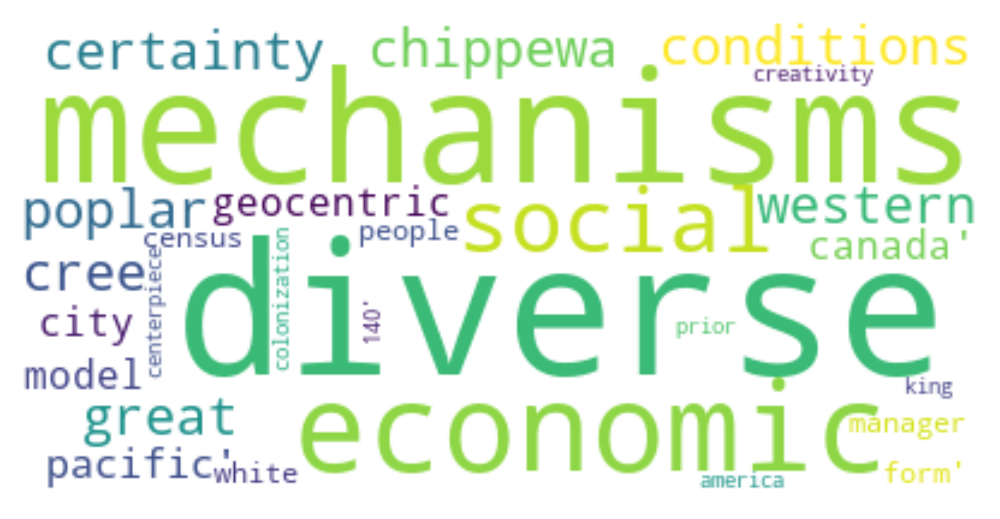

In [13]:
print('Highest interaction tweets')
cloud(string(pop))

Popular tweets from females


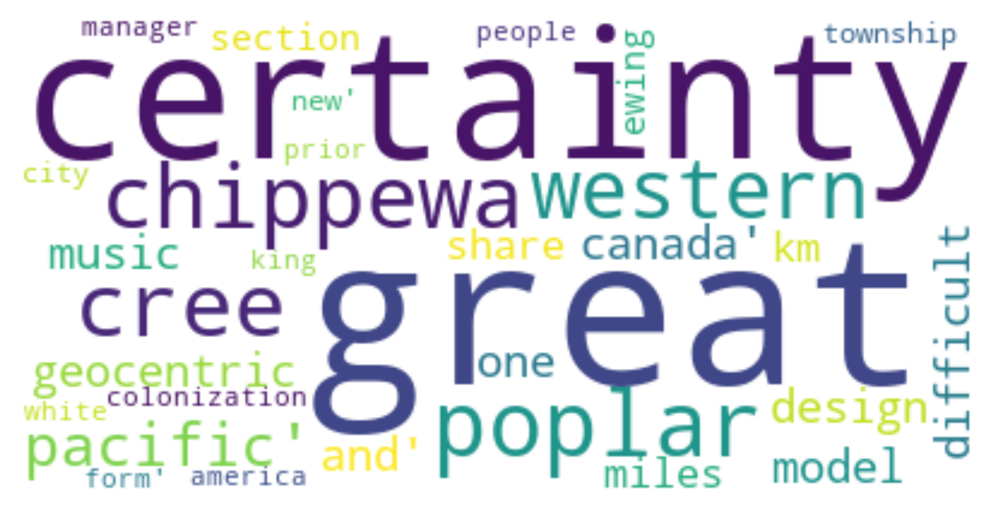

Popular tweets from males


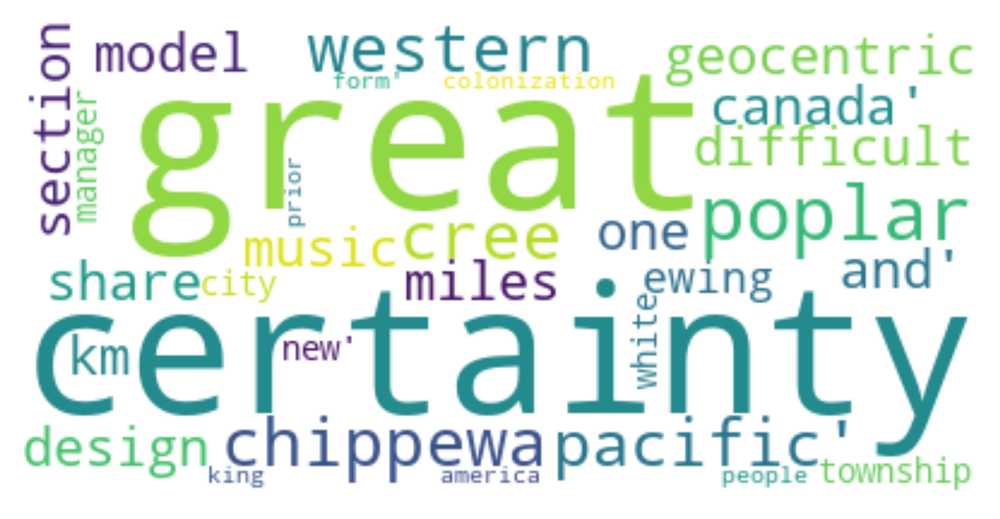

In [14]:
popf = pop[pop.gender == 'female']
popm = pop[pop.gender != 'male']
print('Popular tweets from females')
cloud(string(popf))
print('Popular tweets from males')
cloud(string(popm))

In [17]:
def age(i1,i2):
    df = tw[tw.age.between(i1,i2)]
    return df

Teens


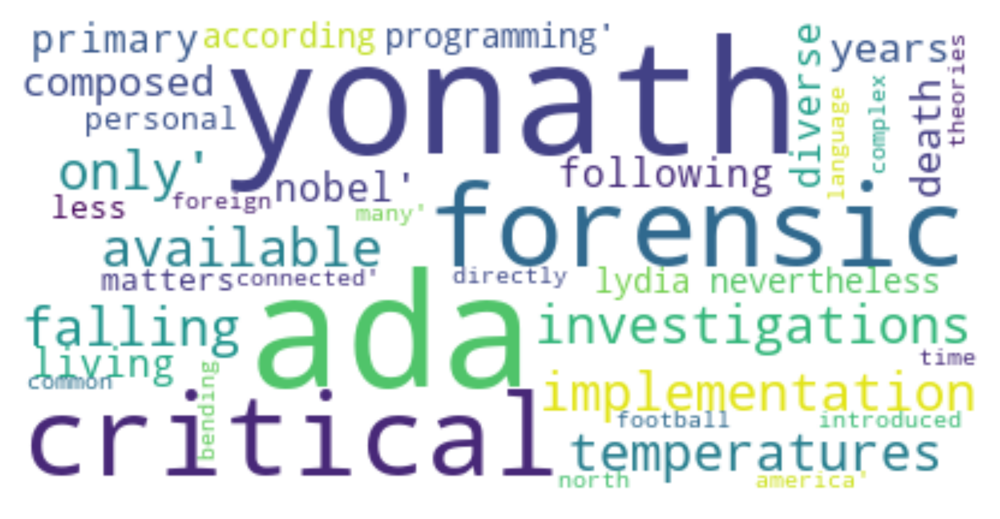

People in their 20s


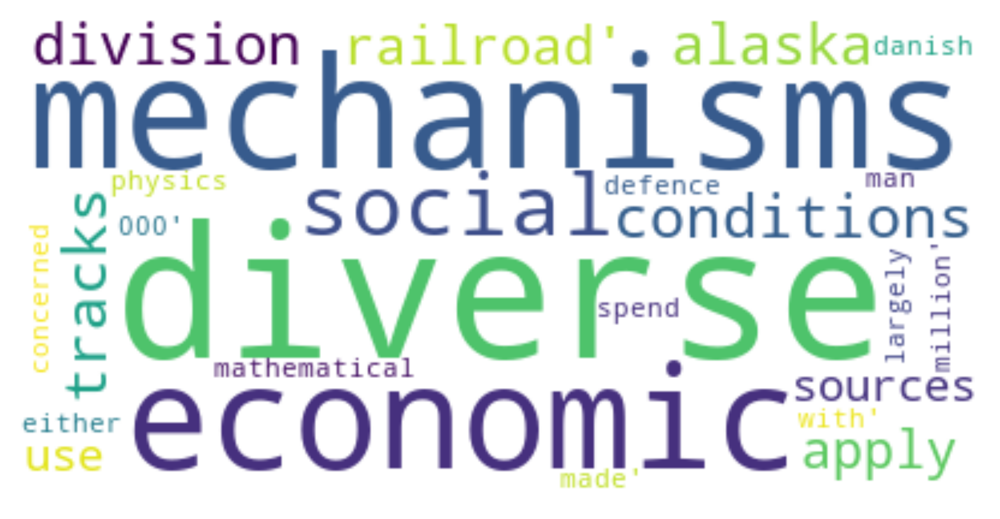

People in their 30s


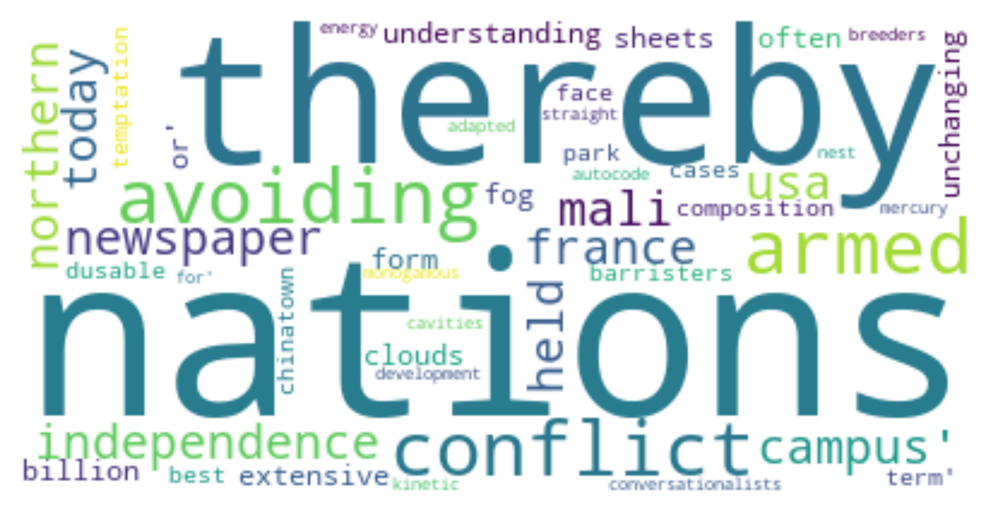

People in their 40s


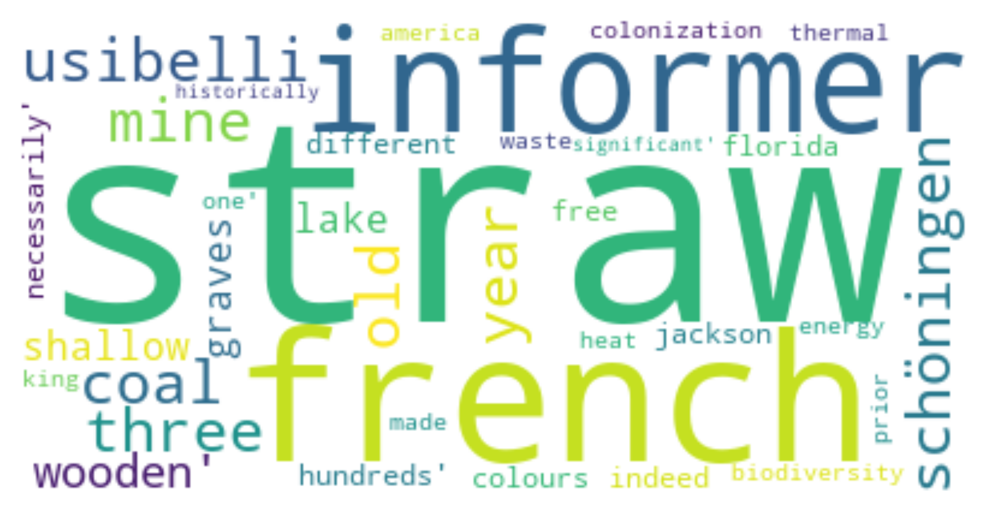

People in their 50s


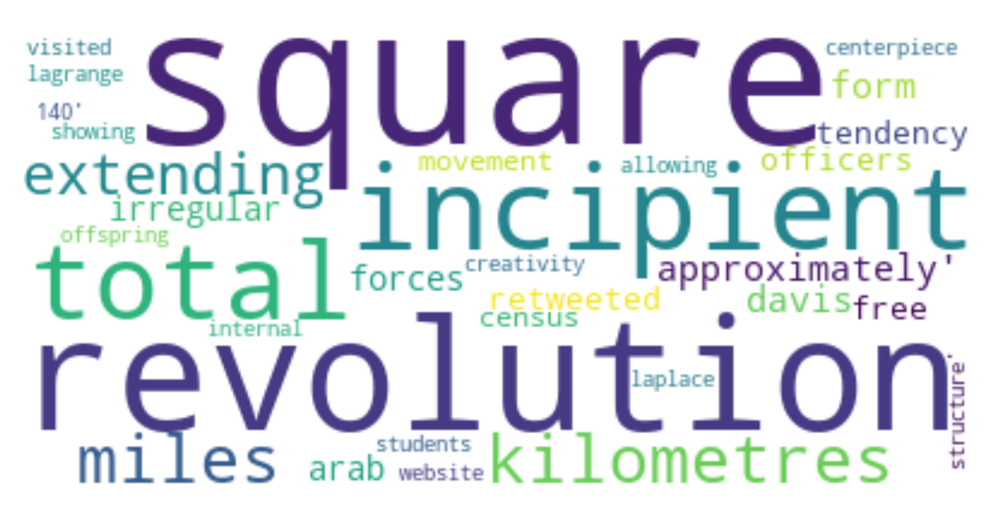

People in their 60s


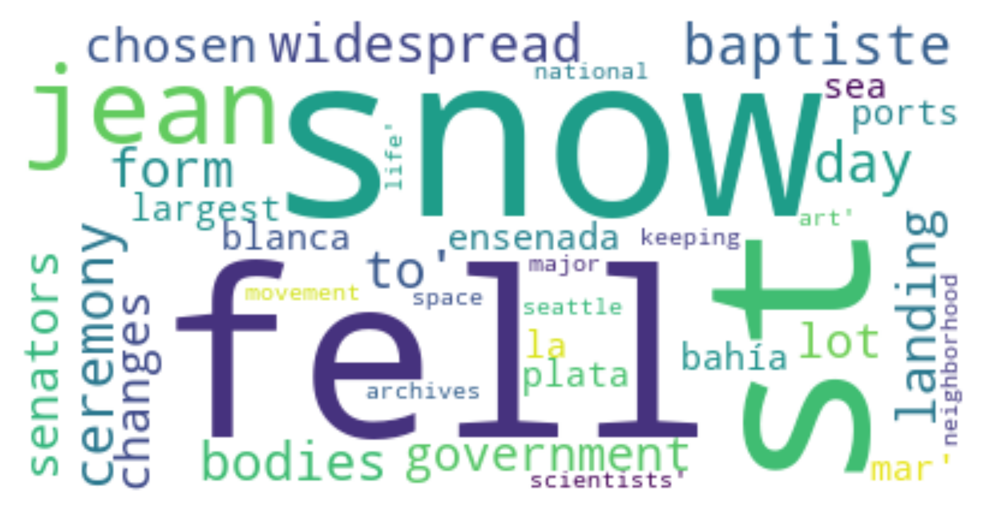

People in their 70s


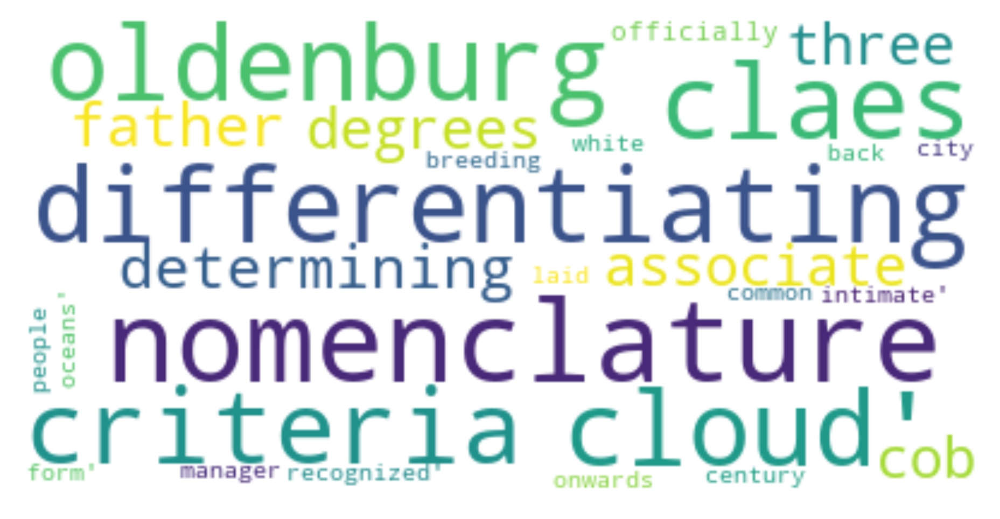

In [19]:
print('Teens')
cloud(string(age(10,19)))
print('People in their 20s')
cloud(string(age(20,29)))
print('People in their 30s')
cloud(string(age(30,39)))
print('People in their 40s')
cloud(string(age(40,49)))
print('People in their 50s')
cloud(string(age(50,59)))
print('People in their 60s')
cloud(string(age(60,69)))
print('People in their 70s')
cloud(string(age(70,79)))